In [50]:
import sys
sys.path.append("/scratch/group/csce435-f24/python-3.10.4/lib/python3.10/site-packages")
sys.path.append("/scratch/group/csce435-f24/thicket")
from glob import glob

import matplotlib.pyplot as plt
import pandas as pd

import thicket as th

pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)
import math

In [51]:
tk = th.Thicket.from_caliperreader(glob("../../cali_files/sample_sort/*.cali"))

(2/2) Creating Thicket: 100%|██████████| 279/279 [00:10<00:00, 25.53it/s]


In [52]:
print(tk.tree(metric_column="Avg time/rank"))

  _____ _     _      _        _   
 |_   _| |__ (_) ___| | _____| |_ 
   | | | '_ \| |/ __| |/ / _ \ __|
   | | | | | | | (__|   <  __/ |_ 
   |_| |_| |_|_|\___|_|\_\___|\__|  v2024.1.0

2.262 main
├─ 0.008 MPI_Comm_dup
├─ 0.000 MPI_Comm_rank
├─ 0.000 MPI_Comm_size
├─ 0.000 MPI_Finalize
├─ 0.000 MPI_Finalized
├─ 1.814 MPI_Init
│  └─ 0.000 MPI_Init
├─ 0.000 MPI_Initialized
├─ 0.287 comm
│  ├─ 0.036 comm_large
│  │  ├─ 0.008 MPI_Alltoall
│  │  │  └─ 0.008 MPI_Alltoall
│  │  └─ 0.029 MPI_Alltoallv
│  │     └─ 0.029 MPI_Alltoallv
│  └─ 0.251 comm_small
│     ├─ 0.249 MPI_Bcast
│     │  └─ 0.249 MPI_Bcast
│     └─ 0.002 MPI_Gather
│        └─ 0.002 MPI_Gather
├─ 0.087 comp
│  ├─ 0.087 comp_large
│  └─ 0.000 comp_small
├─ 0.051 correctness_check
│  ├─ 0.010 MPI_Allreduce
│  ├─ 0.040 MPI_Recv
│  └─ 0.000 MPI_Send
└─ 0.007 data_init_runtime

Legend (Metric: Avg time/rank Min: 0.00 Max: 2.26 indices: {'profile': 17802847})
█ 2.04 - 2.26
█ 1.58 - 2.04
█ 1.13 - 1.58
█ 0.68 - 1.13
█ 0.23 - 0.68
█ 

In [53]:
tk.metadata_column_to_perfdata("num_procs")
tk.metadata_column_to_perfdata("input_size")
tk.metadata_column_to_perfdata("input_type")



tk.dataframe = tk.dataframe.reset_index().set_index(["node", "num_procs", "input_size", "input_type"]).sort_index()

tk.dataframe.head()

profile  \
node                                 num_procs input_size input_type                          
{'name': 'main', 'type': 'function'} 2         65536      one_percent_perturbed  2719668922   
                                                          random                 1434151045   
                                                          reverse_sorted         1064287126   
                                                          sorted                 3574514290   
                                               262144     one_percent_perturbed   415350208   

                                                                                 nid  \
node                                 num_procs input_size input_type                   
{'name': 'main', 'type': 'function'} 2         65536      one_percent_perturbed  1.0   
                                                          random                 1.0   
                                                          reverse_sorted         1.0   
                                                          sorted                 1.0   
                                               262144     one_percent_perturbed  1.0   

                                                                                  spot.channel  \
node                                 num_procs input_size input_type                             
{'name': 'main', 'type': 'function'} 2         65536      one_percent_perturbed  regionprofile   
                                                          random                 regionprofile   
                                                          reverse_sorted         regionprofile   
                                                          sorted                 regionprofile   
                                               262144     one_percent_perturbed  regionprofile   

                                                                                 Min time/rank  \
node                                 num_procs input_size input_type                             
{'name': 'main', 'type': 'function'} 2         65536      one_percent_perturbed       0.303891   
                                                          random                      0.433005   
                                                          reverse_sorted              0.310325   
                                                          sorted                      0.299015   
                                               262144     one_percent_perturbed       0.416280   

                                                                                 Max time/rank  \
node                                 num_procs input_size input_type                             
{'name': 'main', 'type': 'function'} 2         65536      one_percent_perturbed       0.304257   
                                                          random                      0.433006   
                                                          reverse_sorted              0.310509   
                                                          sorted                      0.299876   
                                               262144     one_percent_perturbed       0.417118   

                                                                                 Avg time/rank  \
node                                 num_procs input_size input_type                             
{'name': 'main', 'type': 'function'} 2         65536      one_percent_perturbed       0.304074   
                                                          random                      0.433005   
                                                          reverse_sorted              0.310417   
                                                          sorted                      0.299446   
                                               262144     one_percent_perturbed       0.416699   

                                                     

In [54]:
df = tk.dataframe
df

profile  \
node                                              num_procs input_size input_type                          
{'name': 'main', 'type': 'function'}              2         65536      one_percent_perturbed  2719668922   
                                                                       random                 1434151045   
                                                                       reverse_sorted         1064287126   
                                                                       sorted                 3574514290   
                                                            262144     one_percent_perturbed   415350208   
                                                                       random                 4129096359   
                                                                       reverse_sorted         3561072098   
                                                                       sorted                  674313185   
                                                            1048576    one_percent_perturbed  2985522942   
                                                                       random                 4038483948   
                                                                       reverse_sorted         4209882507   
                                                                       sorted                  722560347   
                                                            4194304    one_percent_perturbed  3765197780   
                                                                       random                 1442850592   
                                                                       reverse_sorted         2280522668   
                                                                       sorted                   33541589   
                                                            16777216   one_percent_perturbed  1813245312   
                                                                       random                 3801805128   
                                                                       reverse_sorted         3082928821   
                                                                       sorted                 2397371319   
                                                            67108864   one_percent_perturbed  3682558158   
                                                                       random                  763479541   
                                                                       reverse_sorted          348751559   
                                                                       sorted                 2714904872   
                                                            268435456  one_percent_perturbed  3991888869   
                                                                       random                  872056710   
                                                                       reverse_sorted         1687756583   
                                                                       sorted                 1134823938   
                                                  4         65536      one_percent_perturbed  1775711214   
                                                                       random                 4036383836   
                                                                       reverse_sorted         4245499239   
                                                                       sorted                 1251433148   
                                                            262144     one_percent_perturbed  1653638456   
                                                                       random                 2313874222   
                                                                       reverse_sorted         2648905725   
                                                                       sorted                 2476489

In [30]:
df_main = df[df['name']=='main']
df_main

profile  \
node                                 num_procs input_size input_type                          
{'name': 'main', 'type': 'function'} 2         65536      one_percent_perturbed  2719668922   
                                                          random                 1434151045   
                                                          reverse_sorted         1064287126   
                                                          sorted                 3574514290   
                                               262144     one_percent_perturbed   415350208   
                                                          random                 4129096359   
                                                          reverse_sorted         3561072098   
                                                          sorted                  674313185   
                                               1048576    one_percent_perturbed  2985522942   
                                                          random                 4038483948   
                                                          reverse_sorted         4209882507   
                                                          sorted                  722560347   
                                               4194304    one_percent_perturbed  3765197780   
                                                          random                 1442850592   
                                                          reverse_sorted         2280522668   
                                                          sorted                   33541589   
                                               16777216   one_percent_perturbed  1813245312   
                                                          random                 3801805128   
                                                          reverse_sorted         3082928821   
                                                          sorted                 2397371319   
                                               67108864   one_percent_perturbed  3682558158   
                                                          random                  763479541   
                                                          reverse_sorted          348751559   
                                                          sorted                 2714904872   
                                               268435456  one_percent_perturbed  3991888869   
                                                          random                  872056710   
                                                          reverse_sorted         1687756583   
                                                          sorted                 1134823938   
                                     4         65536      one_percent_perturbed  1775711214   
                                                          random                 4036383836   
                                                          reverse_sorted         4245499239   
                                                          sorted                 1251433148   
                                               262144     one_percent_perturbed  1653638456   
                                                          random                 2313874222   
                                                          reverse_sorted         2648905725   
                                                          sorted                 2476489365   
                                               1048576    one_percent_perturbed  2261666134   
                                                          random                  966294378   
                                                          reverse_sorted         2704900607   
                                                          sorted                 3730286799   
                                               4194304    one_percent_perturbed   134735985   

In [45]:
df_trimmed = None
n = None
for node in tk.graph.traverse():
    if node.frame['name'] == 'main':
        n = node

df_test = tk.dataframe.loc[n, 'Min time/rank']
# df_test2 = df_test.loc[2, 'random']

time_names = ['Min time/rank', 'Max time/rank', 'Avg time/rank', 'Total time', 'Variance time/rank']
input_types= ['one_percent_perturbed', 'random', 'reverse_sorted', 'sorted']
df_test

num_procs  input_size  input_type           
2          65536       one_percent_perturbed      0.303891
                       random                     0.433005
                       reverse_sorted             0.310325
                       sorted                     0.299015
           262144      one_percent_perturbed      0.416280
                       random                     0.426813
                       reverse_sorted             0.425356
                       sorted                     0.427289
           1048576     one_percent_perturbed      0.983577
                       random                     0.957489
                       reverse_sorted             0.979338
                       sorted                     0.953737
           4194304     one_percent_perturbed      3.431151
                       random                     3.468846
                       reverse_sorted             3.403719
                       sorted                     3.374402
           

KeyError: (65536, 'random')

In [26]:
input_sizes = [2**16, 2**18, 2**20, 2**22, 2**24, 2**26, 2**28]
for node in tk.graph.traverse():
    if node.frame['name'] not in ['main', 'comp_large', 'comm']:
        continue
    
    for input_size in input_sizes:
        for 
        

KeyError: 'num_procs'

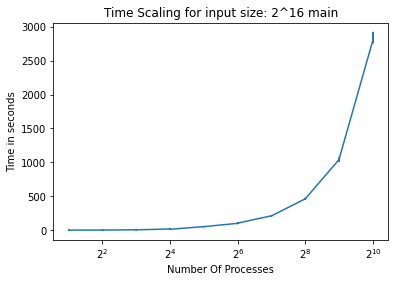

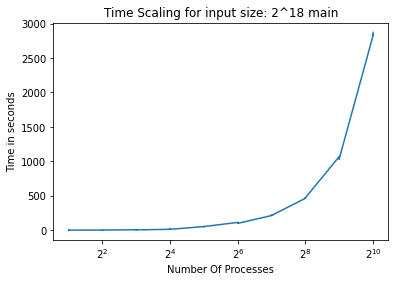

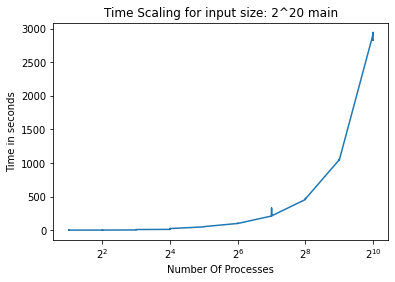

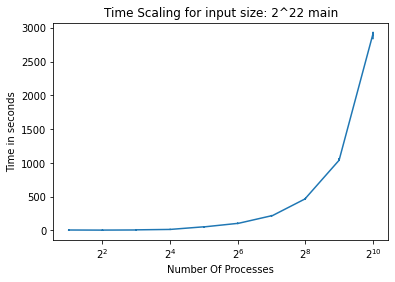

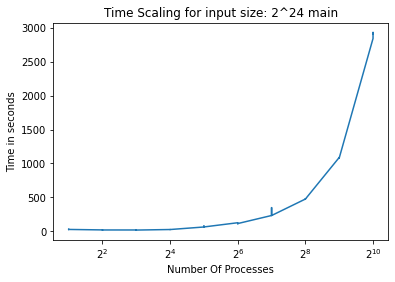

...

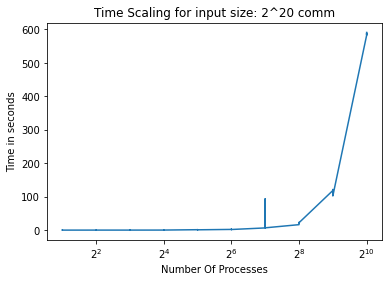

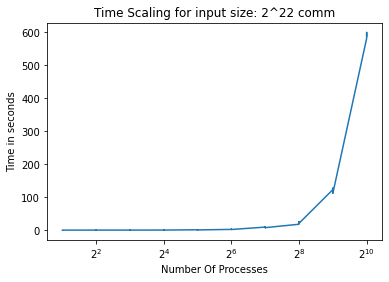

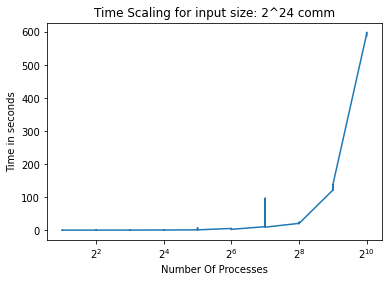

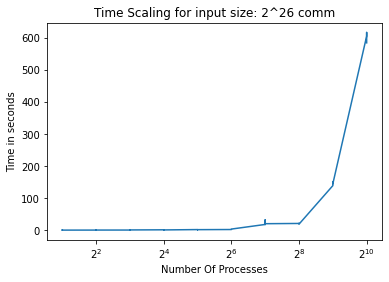

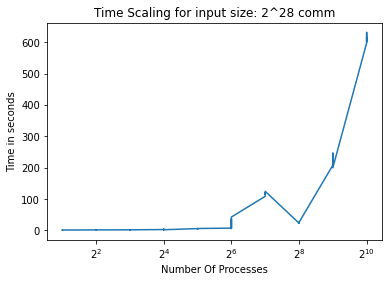

<Figure size 432x288 with 0 Axes>

In [55]:
input_sizes = [65536, 262144, 1048576, 4194304, 16777216, 67108864, 268435456]

for task in ["main", "comp_large", "comm"]:


    df_task = df[df['name'] == task]
#     print("START")
#     print(df_task.head())
#     print("END")
    df_unique = df_task[~df_task.index.duplicated(keep='first')]
#     print("START")
#     print(df_unique.head())
#     print("END")
    
    for input_size in input_sizes: 

        filtered_df = df_unique.xs(input_size, level='input_size')
        filtered_df_reset = filtered_df.reset_index(level='num_procs')
        
#         print(filtered_df.head)
#         print(filtered_df_reset.head)
        

        plt.title("Time Scaling for input size: 2^{} {}".format(int(math.log2(input_size)), task))
        plt.plot(filtered_df_reset['num_procs'], filtered_df_reset['Total time'])
        plt.xlabel("Number Of Processes")
        plt.ylabel("Time in seconds")
        plt.xscale('log', base=2)
        plt.show()
        plt.savefig('plot_{}_{}'.format(input_size, task))

[26.400579 24.376902 26.294954 26.09119  16.158401 15.120786 15.485595
 16.478468 13.671426 13.456521 13.498595 13.441469 12.675947 12.892048
 12.673465 12.667873 12.091821 12.322518 12.521256 12.080826 11.664317
 11.780881 11.557725 11.592163 11.130108 11.355787 11.131339 11.117121
 10.795605 11.011643 10.721669 10.700146 10.045094 10.320725 10.085865
 10.087216 10.637591 10.102003 12.077983 10.811251]


ValueError: x and y must have same first dimension, but have shapes (10,) and (40,)

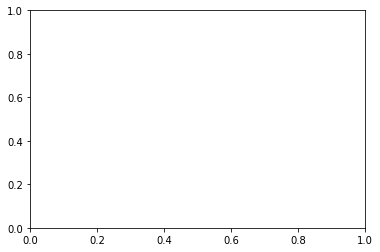

In [57]:
for task in ["comp", "comp_large", "comm"]:


    df_task = df[df['name'] == task]
    df_unique = df_task[~df_task.index.duplicated(keep='first')]



    filtered_df = df_unique.xs(input_sizes[4], level='input_size')
    filtered_df_reset = filtered_df.reset_index(level='num_procs')


    t_min = filtered_df_reset[filtered_df_reset['num_procs']==2]['Total time'].values[0]
    t_min

    speed_up = list(t_min / filtered_df_reset['Total time'].values)
    print(filtered_df_reset['Total time'].values)

    num_procs_possible = [2, 4, 8, 16, 32, 64, 128, 256, 512, 1024]
    

    plt.plot(num_procs_possible, speed_up)
    plt.title("Strong Scaling Speed Up for {}".format(task))
    plt.xlabel("Number Of Processes")
    plt.ylabel("Speed Up")
    plt.show()

profile  \
node                                          num_procs input_size               
{'name': 'main', 'type': 'function'}          1024      65536       1492602070   
{'name': 'MPI_Init', 'type': 'function'}      1024      65536       1492602070   
                                                        65536       1492602070   
{'name': 'MPI_Comm_rank', 'type': 'function'} 1024      65536       1492602070   
{'name': 'MPI_Comm_size', 'type': 'function'} 1024      65536       1492602070   

                                                                    nid  \
node                                          num_procs input_size        
{'name': 'main', 'type': 'function'}          1024      65536       1.0   
{'name': 'MPI_Init', 'type': 'function'}      1024      65536       2.0   
                                                        65536       3.0   
{'name': 'MPI_Comm_rank', 'type': 'function'} 1024      65536       4.0   
{'name': 'MPI_Comm_size', 'type': 'function'} 1024      65536       5.0   

                                                                     spot.channel  \
node                                          num_procs input_size                  
{'name': 'main', 'type': 'function'}          1024      65536       regionprofile   
{'name': 'MPI_Init', 'type': 'function'}      1024      65536       regionprofile   
                                                        65536       regionprofile   
{'name': 'MPI_Comm_rank', 'type': 'function'} 1024      65536       regionprofile   
{'name': 'MPI_Comm_size', 'type': 'function'} 1024      65536       regionprofile   

                                                                    Min time/rank  \
node                                          num_procs input_size                  
{'name': 'main', 'type': 'function'}          1024      65536            2.769804   
{'name': 'MPI_Init', 'type': 'function'}      1024      65536            2.174704   
                                                        65536            0.000027   
{'name': 'MPI_Comm_rank', 'type': 'function'} 1024      65536            0.000005   
{'name': 'MPI_Comm_size', 'type': 'function'} 1024      65536            0.000005   

                                                                    Max time/rank  \
node                                          num_procs input_size                  
{'name': 'main', 'type': 'function'}          1024      65536            3.088821   
{'name': 'MPI_Init', 'type': 'function'}      1024      65536            2.645168   
                                                        65536            0.000158   
{'name': 'MPI_Comm_rank', 'type': 'function'} 1024      65536            0.000023   
{'name': 'MPI_Comm_size', 'type': 'function'} 1024      65536            0.000015   

                                                                    Avg time/rank  \
node                                          num_procs input_size                  
{'name': 'main', 'type': 'function'}          1024      65536            3.005249   
{'name': 'MPI_Init', 'type': 'function'}      1024      65536            2.397902   
                                                        65536            0.000035   
{'name': 'MPI_Comm_rank', 'type': 'function'} 1024      65536            0.000006   
{'name': 'MPI_Comm_size', 'type': 'function'} 1024      65536            0.000005   

                                                                     Total time  \
node                                          num_procs input_size                
{'name': 'main', 'type': 'function'}          1024      65536       3077.374543   
{'name': 'MPI_Init', 'type': 'function'}      1024      65536       2455.451345   
                                                        65536          0.035560   
{'name': 'MPI_Comm_rank', 'type': 'function'} 1024      65536          0.006290   
{'name': 'MPI_Comm_size', 'type': 'function'} 1024      65536          0.005112   

    

IndexError: index 0 is out of bounds for axis 0 with size 0